[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/juansensio/blog/blob/master/066_gol/gol.ipynb)

# El Juego de la Vida en 5 niveles

intro


## Noob

Estás aprendiendo a programar

In [8]:
import random 

def init(Nx, Ny):
    C = [[0 for j in range(Nx)] for i in range(Ny)]
    for i in range(Ny):
        for j in range(Nx):
            C[i][j] = random.randint(0,1)
    return C
    
C0 = init(5, 5)
C0

[[0, 1, 1, 1, 1],
 [1, 0, 1, 1, 1],
 [0, 1, 1, 1, 0],
 [0, 1, 0, 0, 0],
 [0, 1, 1, 0, 0]]

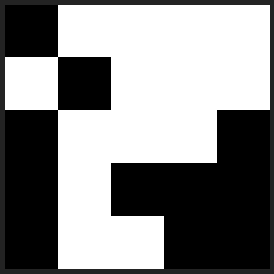

In [9]:
import matplotlib.pyplot as plt

def plot(C, ax=None):
    if ax is None:
        fig, ax = plt.subplots(dpi=50)
    ax.imshow(C, cmap="gray")
    ax.axis('off')
    
plot(C0)

In [10]:
def gol(C, MAX_IT):
    count = 0
    Cs = [C]
    Ny, Nx = len(C), len(C[0])
    while count < MAX_IT:
        C0 = [[0 for j in range(Nx)] for i in range(Ny)]
        for i in range(Ny):
            for j in range(Nx):
                # estado actual
                c = C[i][j]
                # numero vecinos
                v = C[i][j+1] + C[i][j-1] + C[i-1][j] + C[i+1][j] + \
                    C[i+1][j+1] + C[i+1][j-1] + C[i-1][j+1] + C[i-1][j-1]
                # nuevo estado
                if c == 0 and v == 3:
                    C0[i][j] = 1
                elif c == 1 and (v == 2 or v == 3):
                    C0[i][j] = 1
                else:
                    C0[i][j] = 0
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [11]:
C = init(20, 20)
Cs = gol(C, 10)

IndexError: list index out of range

In [12]:
def gol(C, MAX_IT):
    count = 0
    Cs = [C]
    Ny, Nx = len(C), len(C[0])
    while count < MAX_IT:
        C0 = [[0 for j in range(Nx)] for i in range(Ny)]
        for i in range(Ny):
            for j in range(Nx):
                # estado actual
                c = C[i][j]
                # numero vecinos
                v = 0
                if j > 0:
                    v += C[i][j-1]
                if j < Nx - 1:
                    v += C[i][j+1]
                if i > 0:
                    v += C[i-1][j]
                    if j > 0:
                        v += C[i-1][j-1]
                    if j < Nx - 1:
                        v += C[i-1][j+1]
                if i < Ny - 1:
                    v += C[i+1][j]
                    if j > 0:
                        v += C[i+1][j-1]
                    if j < Nx - 1:
                        v += C[i+1][j+1]
                # nuevo estado
                if c == 0 and v == 3:
                    C0[i][j] = 1
                elif c == 1 and (v == 2 or v == 3):
                    C0[i][j] = 1
                else:
                    C0[i][j] = 0
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [13]:
C = init(10, 10)
Cs = gol(C, 10)

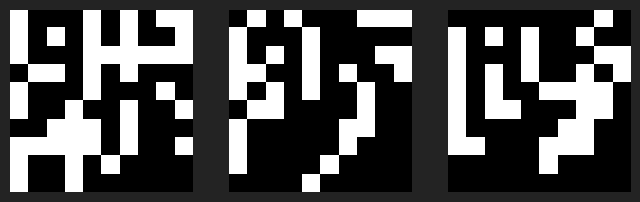

In [14]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1, 3, 1)
plot(Cs[0], ax)
ax = plt.subplot(1, 3, 2)
plot(Cs[1], ax)
ax = plt.subplot(1, 3, 3)
plot(Cs[2], ax)
plt.show()

In [17]:
C = init(200, 200)
%time Cs = gol(C, 200)

CPU times: user 5.7 s, sys: 15.8 ms, total: 5.72 s
Wall time: 5.72 s


In [18]:
# animación

from matplotlib import animation, rc
rc('animation', html='html5')

def update(i):
    ax.clear()
    ax.imshow(Cs[i], cmap="gray")
    ax.axis('off')
    return ax

fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Principante

Sabes que puedes hacerlo mejor


In [19]:
def init(Nx, Ny):
    C = [[0 for j in range(Nx+2)] for i in range(Ny+2)]
    for i in range(1,Ny+1):
        for j in range(1,Nx+1):
            C[i][j] = random.randint(0,1)
    return C
    
init(3, 3)

[[0, 0, 0, 0, 0],
 [0, 1, 0, 1, 0],
 [0, 1, 0, 1, 0],
 [0, 0, 0, 1, 0],
 [0, 0, 0, 0, 0]]

In [20]:
def gol(C, MAX_IT):
    count = 0
    Cs = [C]
    Ny, Nx = len(C)-2, len(C[0])-2
    while count < MAX_IT:
        C0 = [[0 for j in range(Nx+2)] for i in range(Ny+2)]
        for i in range(1, Ny+1):
            for j in range(1, Nx+1):
                # estado actual
                c = C[i][j]
                # numero vecinos
                v = C[i][j+1] + C[i][j-1] + C[i-1][j] + C[i+1][j] + \
                    C[i+1][j+1] + C[i+1][j-1] + C[i-1][j+1] + C[i-1][j-1]
                # nuevo estado
                if c == 0 and v == 3:
                    C0[i][j] = 1
                elif c == 1 and (v == 2 or v == 3):
                    C0[i][j] = 1
                else:
                    C0[i][j] = 0
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [21]:
C = init(200, 200)
%time Cs = gol(C, 200)

CPU times: user 4.26 s, sys: 28 ms, total: 4.29 s
Wall time: 4.29 s


In [22]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Intermedio

En busca de la performance

matrices

In [23]:
import numpy as np

def init(Nx, Ny):
    C = np.random.randint(0, 2, (Ny*Nx,1))
    #C = np.ones((Ny*Nx,))
    return C

Ny, Nx = 3, 3
init(Ny, Nx).ravel()

array([1, 1, 0, 1, 1, 1, 0, 1, 0])

In [24]:
init(Ny, Nx).reshape(Ny, Nx)

array([[0, 1, 0],
       [1, 1, 0],
       [1, 0, 0]])

In [25]:
def vecinos(Nx, Ny):
    V = np.zeros((Ny*Nx, Ny*Nx))
    for j in range(Ny*Nx):
        if j > 0 and j % Nx:
            V[j][j-1] = 1
        if j < Ny*Nx - 1 and (j+1) % Nx:
            V[j][j+1] = 1
        if j >= Nx:
            V[j][j-Nx] = 1
            if (j+1) % Nx:
                V[j][j-Nx+1] = 1
            if j % Nx:
                V[j][j-Nx-1] = 1
        if j <= (Ny-1)*Nx - 1:
            V[j][j+Nx] = 1
            if j % Nx:
                V[j][j+Nx-1] = 1
            if (j+1) % Nx:
                V[j][j+Nx+1] = 1
    return V

Nx, Ny = 3, 3
vecinos(Nx, Ny)

array([[0., 1., 0., 1., 1., 0., 0., 0., 0.],
       [1., 0., 1., 1., 1., 1., 0., 0., 0.],
       [0., 1., 0., 0., 1., 1., 0., 0., 0.],
       [1., 1., 0., 0., 1., 0., 1., 1., 0.],
       [1., 1., 1., 1., 0., 1., 1., 1., 1.],
       [0., 1., 1., 0., 1., 0., 0., 1., 1.],
       [0., 0., 0., 1., 1., 0., 0., 1., 0.],
       [0., 0., 0., 1., 1., 1., 1., 0., 1.],
       [0., 0., 0., 0., 1., 1., 0., 1., 0.]])

In [26]:
C = init(Nx, Ny)
V = vecinos(Nx, Ny)

N = V.dot(C)
N.reshape(Ny, Nx)

array([[1., 3., 2.],
       [3., 3., 2.],
       [2., 2., 3.]])

In [27]:
C.reshape(Ny, Nx)

array([[1, 0, 0],
       [0, 1, 1],
       [0, 1, 0]])

In [28]:
def gol_np(C, V, MAX_IT):
    count = 0
    Cs = [C]
    while count < MAX_IT:
        C0 = np.zeros(C.shape)
        N = V.dot(C)
        C0[(C == 0) & (N == 3)] = 1
        C0[(C == 1) & ((N == 2) | (N == 3))] = 1
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [29]:
Nx, Ny = 200, 200

C = init(Nx, Ny)
V = vecinos(Nx, Ny)
    
%time Cs = gol_np(C, V, 200)

CPU times: user 24 s, sys: 3.43 s, total: 27.4 s
Wall time: 2.74 s


In [30]:
def update(i):
    ax.clear()
    ax.imshow(Cs[i].reshape((Ny,Nx)), cmap="gray")
    ax.axis('off')
    return ax

In [31]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Avanzado

No es suficiente

programación en paralelo

In [32]:
import multiprocessing

num_cores = multiprocessing.cpu_count()
num_cores

20

In [33]:
from concurrent.futures import ProcessPoolExecutor

def f(i):
    #print(f"hola soy {i} \n")
    return i*2
    
p = list(range(num_cores))

with ProcessPoolExecutor(max_workers=num_cores) as pool:
    results = list(pool.map(f, p))
    
results

[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34, 36, 38]

In [34]:
def itera(args):
    C, V, block_size, i = args
    N = V.dot(C)
    C = C[i*block_size:(i+1)*block_size]
    C0 = np.zeros(block_size)
    C0[(C == 0) & (N == 3)] = 1
    C0[(C == 1) & ((N == 2) | (N == 3))] = 1
    return C0

In [35]:
def gol_mp(p, C, V, MAX_IT):
    with ProcessPoolExecutor(max_workers=len(p)) as pool:
        count = 0
        Cs = [C]
        block_size = len(C) // len(p)
        while count < MAX_IT:
            args = ((C, V[i*block_size:(i+1)*block_size,:], block_size, i) for i in p)
            results = list(pool.map(itera, args))
            C0 = np.stack(results).ravel()
            Cs.append(C0)
            C = C0
            count += 1
    return Cs

In [ ]:
p = [0, 1, 2, 3, 5]#list(range(num_cores))
MAX_IT = 10
Nx, Ny = 50, 50

C = init(Nx, Ny)
V = vecinos(Nx, Ny)

%time Cs = gol_mp(p, C, V, MAX_IT)

In [ ]:
fig = plt.figure(dpi=50)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Pro

Al límite, gpu

In [36]:
import torch

def gol_torch(C, V, MAX_IT, device="cpu"):
    with torch.no_grad():
        Cs = [C]
        C = C.to(device)
        V = V.to(device)
        count = 0
        while count < MAX_IT:
            N = V @ C
            C0 = torch.zeros(C.shape).to(device)
            C0[(C == 0) & (N == 3)] = 1
            C0[(C == 1) & ((N == 2) | (N == 3))] = 1
            Cs.append(C0.cpu())
            C = C0
            count += 1
        return Cs

In [43]:
Nx, Ny = 200, 200

C = torch.from_numpy(init(Nx, Ny)).float()
V =  torch.from_numpy(vecinos(Nx, Ny)).float()

%time Cs = gol_torch(C, V, 200)

In [48]:
%time Cs = gol_torch(C, V, 200, 'cuda')

CPU times: user 15.8 s, sys: 223 ms, total: 16.1 s
Wall time: 2.21 s


In [39]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

In [49]:
Nx, Ny = 1000, 1000

C = torch.from_numpy(init(Nx, Ny)).float()
V =  torch.from_numpy(vecinos(Nx, Ny)).float()

%time Cs = gol_torch(C, V, 500)

MemoryError: Unable to allocate 7.28 TiB for an array with shape (1000000, 1000000) and data type float64

## Bonus: Nivel Dios

sparse

In [50]:
from scipy.sparse import csr_matrix

def vecinos_sp(Nx, Ny):
    data, indices, indptr = [], [], [0]
    for i in range(Ny*Nx):
        if i > 0 and i % Nx:
            data.append(1)
            indices.append(i-1)
        if i < Ny*Nx - 1 and (i+1) % Nx:
            data.append(1)
            indices.append(i+1)
        if i >= Nx:
            data.append(1)
            indices.append(i-Nx)
            if (i+1) % Nx:
                data.append(1)
                indices.append(i-Nx+1)
            if i % Nx:
                data.append(1)
                indices.append(i-Nx-1)
        if i <= (Ny-1)*Nx - 1:
            data.append(1)
            indices.append(i+Nx)
            if i % Nx:
                data.append(1)
                indices.append(i+Nx-1)
            if (i+1) % Nx:
                data.append(1)
                indices.append(i+Nx+1)
        indptr.append(len(indices))
    return csr_matrix((data, indices, indptr))

Nx, Ny = 3, 3
vecinos_sp(Nx, Ny).toarray()

array([[0, 1, 0, 1, 1, 0, 0, 0, 0],
       [1, 0, 1, 1, 1, 1, 0, 0, 0],
       [0, 1, 0, 0, 1, 1, 0, 0, 0],
       [1, 1, 0, 0, 1, 0, 1, 1, 0],
       [1, 1, 1, 1, 0, 1, 1, 1, 1],
       [0, 1, 1, 0, 1, 0, 0, 1, 1],
       [0, 0, 0, 1, 1, 0, 0, 1, 0],
       [0, 0, 0, 1, 1, 1, 1, 0, 1],
       [0, 0, 0, 0, 1, 1, 0, 1, 0]])

In [51]:
Nx, Ny = 200, 200

C = init(Nx, Ny)
V = vecinos_sp(Nx, Ny)

In [52]:
%time Cs = gol_np(C, V, 200)

CPU times: user 123 ms, sys: 3.96 ms, total: 127 ms
Wall time: 126 ms


In [53]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

In [54]:
Nx, Ny = 1000, 1000

C = init(Nx, Ny)
V = vecinos_sp(Nx, Ny)

In [59]:
%time Cs = gol_np(C, V, 100)

CPU times: user 2.08 s, sys: 840 ms, total: 2.92 s
Wall time: 2.91 s


In [60]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Resumen

Esto sirve para redes neuronales, simulación de fluidos, etc.

Otros aspectos a tener en cuenta: operaciones con enteros mejor que float, sparse vs block sparse.